<a href="https://colab.research.google.com/github/yuanfeiwo/test-firstrepository/blob/master/Module6_6_1_PredictBankruptcy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Predicting Bankruptcy

Reference:  Shmueli.G, Bruce.P.C, Patel.N.R (2016) _**Data Mining For Business Analytics (Third Edition)**_ Page 499

#### Learning Objectives:
* Explore the dataset by using pandas, numpy, matplotlib.
* Compare the performance of Logistic Regression, Random Forest Classifer and Multi-layer Perceptron classifier.
* Select significant features for new model.
* Build Random Forest Classifier for classification.
* Use confusion_matrix, ROC curve and cross-validation to evaluate model performance.

In [1]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

     - 55.3MB 755kB/s
     |████████████████████████████████| 81kB 4.0MB/s 
     |████████████████████████████████| 604kB 9.1MB/s 
     |████████████████████████████████| 3.1MB 16.1MB/s 
     |████████████████████████████████| 71kB 7.2MB/s 
     |████████████████████████████████| 296kB 36.5MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-2.10.0-py2.py3-none-any.whl size=232422 sha256=cf713674454b356498d759b46d6b9036c67eb7ea6fe935d0b64fbe9999fa8d4e
  Stored in directory: /tmp/pip-ephem-wheel-cache-y581y104/wheels/56/c2/dd/8d945b0443c35df7d5f62fa9e9ae105a2d8b286302b92e0109
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp36-none-any.whl size=27085 sha256=5e8eb5ef47992630e5cd7a083168a76e04d048c2bf52dcbbac6f2c833311ca36
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
Successfully built pandas-profiling htmlmin
  Found existing installation: tqdm 4.41.1
    Uninstalling tqdm-4.41.1:
      Successfully unin

In [2]:
# Import libraries

import pandas as pd
import numpy as np
import os
import time
import csv
import matplotlib as mp
import matplotlib.pyplot as plt
import scipy as sp
import xlrd


%matplotlib inline

pd.options.display.max_columns = 999
pd.options.display.max_rows = 50

The Dataset that we will be using for this Case Study is referenced from the book **Data Mining For Business Analytics (Third Edition)**

You can also download the dataset using the link below: http://www.dataminingbook.com/book/3rd-edition

#### Loading the dataset

In [3]:
!wget --no-check-certificate 'https://docs.google.com/spreadsheets/export?format=xlsx&id=1CKrFc3ekVxAFQMvpW_MYftaHCj0h_HNe' -O Bankruptcy.xlsx

--2020-12-16 18:40:11--  https://docs.google.com/spreadsheets/export?format=xlsx&id=1CKrFc3ekVxAFQMvpW_MYftaHCj0h_HNe
Resolving docs.google.com (docs.google.com)... 172.253.114.100, 172.253.114.102, 172.253.114.113, ...
Connecting to docs.google.com (docs.google.com)|172.253.114.100|:443... connected.
HTTP request sent, awaiting response... 307 Temporary Redirect
Location: https://doc-08-6c-sheets.googleusercontent.com/export/l5l039s6ni5uumqbsj9o11lmdc/ik5ga3d4k3a46t06lh6hvtj788/1608144010000/100319126105214560520/*/1CKrFc3ekVxAFQMvpW_MYftaHCj0h_HNe?format=xlsx&id=1CKrFc3ekVxAFQMvpW_MYftaHCj0h_HNe [following]
--2020-12-16 18:40:11--  https://doc-08-6c-sheets.googleusercontent.com/export/l5l039s6ni5uumqbsj9o11lmdc/ik5ga3d4k3a46t06lh6hvtj788/1608144010000/100319126105214560520/*/1CKrFc3ekVxAFQMvpW_MYftaHCj0h_HNe?format=xlsx&id=1CKrFc3ekVxAFQMvpW_MYftaHCj0h_HNe
Resolving doc-08-6c-sheets.googleusercontent.com (doc-08-6c-sheets.googleusercontent.com)... 172.217.212.132, 2607:f8b0:4001:c03:

In [4]:
# Import dataset
df = pd.read_excel('Bankruptcy.xlsx',sheet_name='data')

In [5]:
# print out the Description in the excel sheet
print('Description of the parameters')
print('')
description = pd.read_excel('Bankruptcy.xlsx',sheet_name='Description')
for idx, row in description.iterrows():
    if (type(row['Source:'])!=float)&(type(row['Unnamed: 1'])!=float):
        print(row['Source:'] + ':   ' +row['Unnamed: 1'])

Description of the parameters

NO:   Arbitrary ID number for each firm.
D:   D=0 for failed firms, D=1 for healthy firms.
YR:   Year of Bankruptcy for failed firm in matched pair
R1:   CASH/CURDEBT
R2:   CASH/SALES
R3:   CASH/ASSETS
R4:   CASH/DEBTS
R5:   CFF0/SALES
R6:   CFFO/ASSETS
R7:   CFFO/DEBTS
R8:   COGS/INV
R9:   CURASS/CURDEBT
R10:   CURASS/SALES
R11:   CURRASS/ASSETS
R12:   CURDEBT/DEBTS
R13:   INC/SALES
R14:   INC/ASSETS
R15:   INC/DEBTS
R16:   UBCDEP/SALES
R17:   INCDEP/ASSETS
R18:   INCDEP/DEBTS
R19:   SALES/REC
R20:   SALES/ASSETS
R21:   ASSETS/DEBTS
R22:   WCFO/SALES
R23:   WCFO/ASSETS
R24:   WCFO/DEBTS


In [8]:
df.columns

Index(['NO', 'D', 'YR', 'R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'R9',
       'R10', 'R11', 'R12', 'R13', 'R14', 'R15', 'R16', 'R17', 'R18', 'R19',
       'R20', 'R21', 'R22', 'R23', 'R24'],
      dtype='object')

In [9]:
feature_list = ['R1', 'R2', 'R3', 'R4', 'R5', 'R6', 'R7', 'R8', 'R9',
       'R10', 'R11', 'R12', 'R13', 'R14', 'R15', 'R16', 'R17', 'R18', 'R19',
       'R20', 'R21', 'R22', 'R23', 'R24']

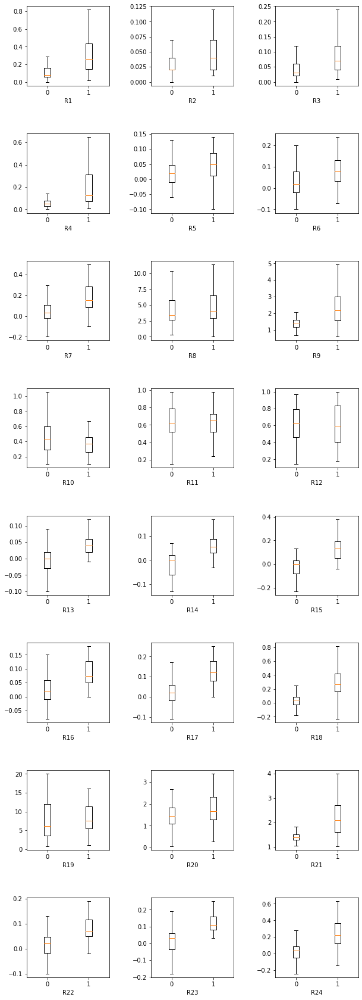

In [10]:
plt.figure(figsize=(10,30), facecolor='white')
plot_number = 1
# get the box plot for each feature
for var in feature_list:
    ax = plt.subplot(8, 3, plot_number)
    ax.set_xlabel(var)   
    table_0 = list(df[df['D']==0][var])
    table_1 = list(df[df['D']==1][var])
    ax.boxplot([table_0, table_1], showfliers=False)
    ax.set_xticklabels([0,1])
    plot_number = plot_number + 1
plt.subplots_adjust(wspace=0.5, hspace=0.6)
plt.show()

### Data Profile

In [11]:
from pandas_profiling import ProfileReport
report = ProfileReport(df)
report 

There are 132 data points with 27 features.

#### Data exploration and Visualization

In [12]:
# Group by feature D and get the mean value of each feature
df.groupby('D').mean()

,NO,YR,R1,R2,R3,R4,R5,R6,R7,R8,R9,R10,R11,R12,R13,R14,R15,R16,R17,R18,R19,R20,R21,R22,R23,R24
D,,,,,,,,,,,,,,,,,,,,,,,,,,
0,33.5,74.015152,0.131212,0.052879,0.049091,0.070000,0.021364,0.028939,0.050000,8.560758,1.405303,0.607121,0.612576,0.615455,-0.042424,-0.033182,-0.030152,0.025909,0.014848,0.034242,13.298182,1.619091,1.408788,0.004545,0.000909,0.019091
1,99.5,74.015152,0.452273,0.069848,0.098485,0.241667,0.061667,0.071515,0.188333,7.596061,2.513485,0.390606,0.611364,0.598939,0.045909,0.061970,0.204545,0.097576,0.128788,0.385606,17.781212,1.911212,2.389545,0.088636,0.116970,0.356970


Split the dataset into df_D0 where D=0 (bankruptcy/failed firm) and df_D1 where D=1 (healthy firm).

In [13]:
df_D0 = df[df['D']==0]
df_D1 = df[df['D']==1]

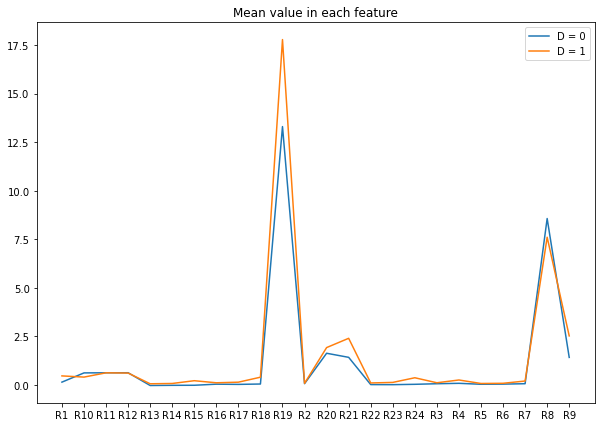

In [14]:
# Plot the mean value of each features in 2 class 
plt.figure(figsize=(10,7))
plt.title('Mean value in each feature')
plt.plot(df_D0[df_D0.columns.difference(['NO', 'YR','D'])].mean(),
         label='D = 0')
plt.plot(df_D1[df_D1.columns.difference(['NO', 'YR','D'])].mean(),
        label='D = 1')
plt.legend()
plt.show()

In [15]:
# To confirm that two sets are paired correctly by year.
list(df_D0.YR) == list(df_D1.YR)

True

Timeline of the bankruptcy

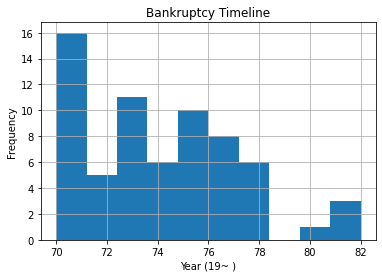

In [16]:
df_D0.YR.hist()
plt.title('Bankruptcy Timeline')
plt.xlabel('Year (19~ )')
plt.ylabel('Frequency')
plt.show()

#### Distribution plotting of each feature

In [17]:
# Select the features as independent variables
features = df[df.columns.difference(['D', 'NO', 'YR'])]
feature_list = features.columns
# Select the target D
D = df["D"]

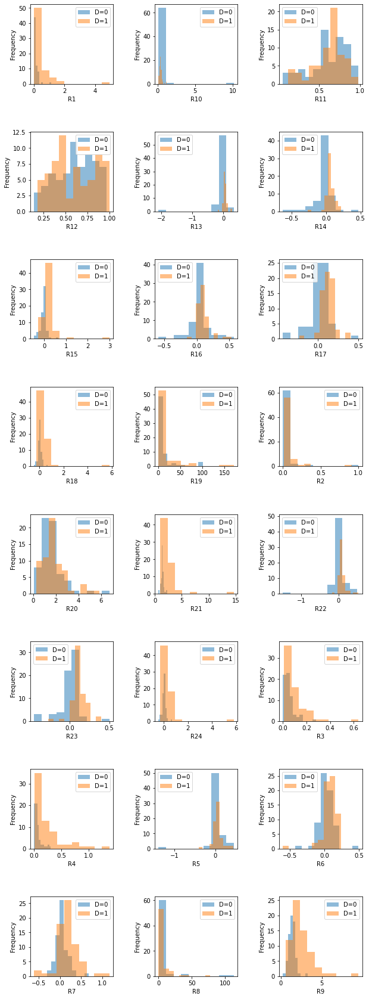

In [18]:
# Plot the 2 D classes distribution of each feature

plt.figure(figsize=(10,30), facecolor='white')
plot_number = 1

for var in features.columns:
    ax = plt.subplot(8, 3, plot_number)
    ax.set_xlabel(var)   
    table_0 = df[df['D']==0][var]
    table_1 = df[df['D']==1][var]

    table_0.plot(kind='hist', alpha=0.5, label='D=0',ax=ax)
    table_1.plot(kind='hist', alpha=0.5,  label='D=1',ax=ax)
    ax.legend()
    plot_number = plot_number + 1
plt.subplots_adjust(wspace=0.5, hspace=0.6)
plt.show()

#### Observation:
a) Features whose Class distributions (D=0, D=1) have more significant difference tend to be a better predictor of the bankruptcy. 
Such as: R17, R22, R23.

b) Features whose Class distributions (D=0, D=1) have less significant difference tend to be a bad predictor of the bankruptcy. 
Such as: R19, R12, R5.

### Build a classifier

'D': binary dependent variable having two possible classes ( D=0 for failed firms, D=1 for healthy firms.)

R1~R24: independent variables (features/predictors).


#### Split into Training and Test sets.

Select independent variable and predictors

In [19]:
# When D=0
features_0 = df_D0[df_D0.columns.difference(['D', 'YR', 'NO'])]
D_0 = df_D0["D"]
# When D=1
features_1 = df_D1[df_D1.columns.difference(['D', 'YR', 'NO'])]
D_1 = df_D1["D"]

Split into Training and Test sets from failed firms (D=0)

Define a function to split the data into training and test set

In [20]:
from sklearn.model_selection import train_test_split

def split_data(features0, D0, features1, D1):
    """
    Since each failed firm has an opposite healthy firm, in order to train a nice model, 
    we collect pairs of corresponding firms in the same train/test dataset. 
    
    Parameters: 
    ----------
    features0: array-like or sparse matrix of shape = [n_samples, n_features]
               samples of failed firms (D=0)
    D0: array-like or sparse matrix of shape = [n_samples, n_features]
        The target values.
    features1: array-like or sparse matrix of shape = [n_samples, n_features]
               samples of healthy firms (D=1)
    D1: array-like or sparse matrix of shape = [n_samples, n_features]
        The target values. 
        
    Return: 
    ----------
    result: list of splitting dataset
            [X_train, X_test, y_train, y_test]
    """
    # Set the size of the test set
    test_size = 0.2
    # Spilit the dataset into training set and test set for only class D=0
    X_train_0, X_test_0, y_train_0, y_test_0 = train_test_split(features0, 
                                                            D0, 
                                                            test_size=test_size,
                                                            random_state = 5 
                                                           )
    # the index of healthy firm = the index of its opposite failed firm + 66 
    train_NO_D1 =[x+66 for x in list(X_train_0.index)]
    test_NO_D1 =[x+66 for x in list(X_test_0.index)] 
    # Select data in class D=1 based on class D=0
    X_train_1 = features1.loc[features1.index.isin(train_NO_D1)]
    X_test_1 = features1.loc[features1.index.isin(test_NO_D1)]
    y_train_1 = D1.loc[D1.index.isin(train_NO_D1)]
    y_test_1 = D1.loc[D1.index.isin(test_NO_D1)]
    
    result = []
    # Concatenate two datasets and append to result
    X_train = pd.concat([X_train_0, X_train_1])
    result.append(X_train)
    X_test = pd.concat([X_test_0, X_test_1])
    result.append(X_test)
    y_train = pd.concat([y_train_0, y_train_1])
    result.append(y_train)
    y_test = pd.concat([y_test_0, y_test_1])
    result.append(y_test)
    
    return result

In [21]:
# Use our defined function to spilit data randomly
X_train, X_test, y_train, y_test = split_data(features_0, D_0, features_1, D_1)

print('Training Features Shape:', X_train.shape)
print('Training Labels Shape:', y_train.shape)
print('Testing Features Shape:', X_test.shape)
print('Testing Labels Shape:', y_test.shape)

Training Features Shape: (104, 24)
Training Labels Shape: (104,)
Testing Features Shape: (28, 24)
Testing Labels Shape: (28,)


#### Comparison of Calibration of Classifiers
Well calibrated classifiers are probabilistic classifiers for which the output of the predict_proba method can be directly interpreted as a confidence level. For instance a well calibrated (binary) classifier should classify the samples such that among the samples to which it gave a predict_proba value close to 0.8, approx. 80% actually belong to the positive class.

Reference: http://scikit-learn.org/stable/auto_examples/calibration/plot_compare_calibration.html#sphx-glr-auto-examples-calibration-plot-compare-calibration-py

#### Hyperparameter tuning
Hyperparameter tuning for Logistic Regression, Random forest classifier and Multi-layer Perceptron classifier with 5-fold cross validation.

In [22]:
# Import the moedels for classification
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier
import warnings
warnings.filterwarnings('ignore')

Define a function to report the best parameters and best score of different models.

In [23]:
def best_param_report(clf, param_grid, X=X_train, y=y_train):
    """
    Print out the optimal parameters and best score in each model. 
    
    Parameters: 
    ----------
    clf: object
            A supervised learning estimator 
    param_grid: dictionary
            Grid of parameters with a discrete number of values for each
    X: array-like or sparse matrix of shape = [n_samples, n_features]
               samples of all firms (D=0 and D=1)
    y: array-like or sparse matrix of shape = [n_samples, n_features]
                The target values D. 
        
    """    

    grid_search = GridSearchCV(clf, param_grid=param_grid, cv=5)
    grid_search.fit(X, y)
    for key in param_grid.keys():
        print('Best {}: {}'.format(key, grid_search.best_estimator_.get_params()[key]))
    print('Best score: {}'.format(grid_search.best_score_))
    

Logistic Regression:

In [24]:
clf = LogisticRegression()
param_grid = {"penalty": ['l1', 'l2'],
              "C": np.linspace(0.1, 0.2, 20),
              }
best_param_report(clf, param_grid)

Best penalty: l2
Best C: 0.1842105263157895
Best score: 0.7980952380952381


Random Forest Classifier:

In [25]:
clf = RandomForestClassifier()
param_grid = {"max_depth": [3, None],
              "max_features": [1, 3, 10],
              "min_samples_split": [2, 3, 10],
              "min_samples_leaf": [1, 3, 10],
              "bootstrap": [True, False],
              "criterion": ["gini", "entropy"]}
best_param_report(clf, param_grid)

Best max_depth: None
Best max_features: 10
Best min_samples_split: 10
Best min_samples_leaf: 10
Best bootstrap: False
Best criterion: gini
Best score: 0.8657142857142857


Multi-layer Perceptron classifier:

In [26]:
clf = MLPClassifier(random_state=42)
param_grid={
            'hidden_layer_sizes': [(30), (15,15), (10,10,10)],
            'activation': ["logistic", "relu", "tanh"]
            }

best_param_report(clf, param_grid)

Best hidden_layer_sizes: 30
Best activation: relu
Best score: 0.8071428571428572


As the best performance report of each model shown above, we select the model with the highest accuracy score: Random Forest Classifier.

In [27]:
# Create a random forest classifier
clf = RandomForestClassifier(max_features=1,
                             bootstrap=False,
                             max_depth=None, 
                             min_samples_leaf=10,
                             criterion='entropy',
                             min_samples_split=3
                            )
model = clf.fit(X_train, y_train)

Accuracy of the prediction

In [28]:
score = model.score(X_test, y_test)
print('The mean accuracy on the test data and labels:')
print(score)

The mean accuracy on the test data and labels:
0.8571428571428571


In [29]:
from sklearn import metrics
# get the confusion matrix of the prediction
predictions = model.predict(X_test)
cm = metrics.confusion_matrix(y_test, predictions)
print(cm)

[[13  1]
 [ 3 11]]


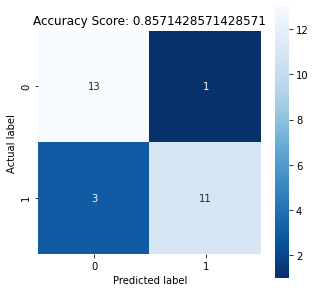

In [30]:
import seaborn as sns
# Visualize the confusion matrix
plt.figure(figsize=(5,5))
sns.heatmap(cm, 
            annot=True,
            square = True, 
            cmap = 'Blues_r')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')\

plt.title('Accuracy Score: {0}'.format(score))
plt.show()

Receiver Operating Characteristic (ROC) metric to evaluate classifier output quality.

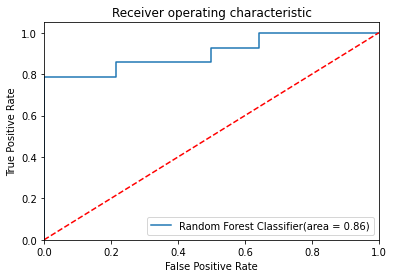

In [31]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
# Compute ROC curve and area the curve
clf_roc_auc = roc_auc_score(y_test, model.predict(X_test))
fpr, tpr, thresholds = roc_curve(y_test, model.predict_proba(X_test)[:,1])

plt.figure()
plt.plot(fpr, tpr, label='Random Forest Classifier(area = %0.2f)' % clf_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.show()

Compute precision, recall and F-score

In [32]:
from sklearn.metrics import classification_report
# Get the report of the model
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.81      0.93      0.87        14
           1       0.92      0.79      0.85        14

    accuracy                           0.86        28
   macro avg       0.86      0.86      0.86        28
weighted avg       0.86      0.86      0.86        28



#### Feature Selection

a) Select features based on the ranking of feature importances

Feature ranking:
1. feature 6 (0.103864)
2. feature 15 (0.092513)
3. feature 23 (0.081413)
4. feature 21 (0.069926)
5. feature 13 (0.067677)
6. feature 5 (0.063319)
7. feature 8 (0.046991)
8. feature 16 (0.046982)
9. feature 9 (0.046817)
10. feature 4 (0.044385)
11. feature 7 (0.043346)
12. feature 20 (0.041792)
13. feature 0 (0.039440)
14. feature 14 (0.036811)
15. feature 18 (0.028279)
16. feature 19 (0.023058)
17. feature 1 (0.022439)
18. feature 17 (0.017403)
19. feature 10 (0.016997)
20. feature 12 (0.016881)
21. feature 22 (0.016812)
22. feature 11 (0.012813)
23. feature 2 (0.012528)
24. feature 3 (0.007514)


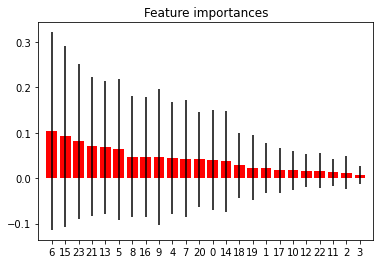

In [33]:
importances = model.feature_importances_
std = np.std([tree.feature_importances_ for tree in model.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")

for f in range(X_train.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plot the impurity-based feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X_train.shape[1]), importances[indices],
        color="r", yerr=std[indices], align="center")
plt.xticks(range(X_train.shape[1]), indices)
plt.xlim([-1, X_train.shape[1]])
plt.show()

We can manually select top 10 features

In [34]:
print ("Features sorted by their score:")
# model = clf.fit(X_train, y_train)
sorted_feature = sorted(zip(map(lambda x: round(x, 5), model.feature_importances_), feature_list), 
             reverse=True)
print (sorted_feature)

Features sorted by their score:
[(0.10386, 'R15'), (0.09251, 'R23'), (0.08141, 'R9'), (0.06993, 'R7'), (0.06768, 'R21'), (0.06332, 'R14'), (0.04699, 'R17'), (0.04698, 'R24'), (0.04682, 'R18'), (0.04439, 'R13'), (0.04335, 'R16'), (0.04179, 'R6'), (0.03944, 'R1'), (0.03681, 'R22'), (0.02828, 'R4'), (0.02306, 'R5'), (0.02244, 'R10'), (0.0174, 'R3'), (0.017, 'R19'), (0.01688, 'R20'), (0.01681, 'R8'), (0.01281, 'R2'), (0.01253, 'R11'), (0.00751, 'R12')]


In [35]:
# Select top 15 significant features as new features
new_features = []
for feature in sorted_feature[:10]:
    new_features.append(feature[1])


features_0_new = features_0[new_features]
features_1_new = features_1[new_features]

X_train_new, X_test_new, y_train_new, y_test_new = split_data(features_0_new, D_0, 
                                                              features_1_new, D_1)
# Create a new random forest classifier
clf = RandomForestClassifier(max_features=1,
                             bootstrap=False,
                             max_depth=None, 
                             min_samples_leaf=10,
                             criterion='entropy',
                             min_samples_split=3
                            )
model_new = clf.fit(X_train_new, y_train_new)

score_new = model_new.score(X_test_new, y_test_new)
print('Compared with the accuracy of old model: {}'.format(score))
print('The mean accuracy of 10 features new model is : {}'.format(score_new))


Compared with the accuracy of old model: 0.8571428571428571
The mean accuracy of 10 features new model is : 0.8571428571428571
